In [8]:
import pandas as pd
import numpy as np
from pandas_profiling import ProfileReport
import pyexasol
import logging
from citymobil_python_clickhouse_wrapper import ClickHouseWrapper

from statsmodels.stats.anova import anova_lm
import statsmodels.api as sm 
import statsmodels.formula.api as sf

%matplotlib inline
import matplotlib.pyplot as plt

import seaborn as sns
import plotly.express as px

from statsmodels.stats.anova import anova_lm
import statsmodels.api as sm 
import statsmodels.formula.api as sf

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.ensemble import RandomForestRegressor

from scipy.stats import norm, chi2_contingency, spearmanr
from statsmodels.stats.power import GofChisquarePower
from statsmodels.stats.gof import chisquare_effectsize

In [98]:
cred = pd.read_json(r'/Users/skostuchik/crd_exa.json')
user = cred.iloc[0, 0]
password = cred.iloc[0, 1]
dsn='ex1..3.city-srv.ru:8563'

cnn = pyexasol.connect(dsn=dsn, user=user, password=password, fetch_dict=True)

In [99]:
# initialize
logger = logging.getLogger()
clickhouse = ClickHouseWrapper(
    logger,
    url="http://chbi-vip.city-srv.ru:8123",
    user=user,
    password=password,
    create_and_assign_event_loop=False,  # for django threads with no event loop
    allow_nested_event_loops=True  # for jupyter threads with existed event loop
)

# <font size="10" color="purple">В разрезе заказов</font>

In [11]:
query_orders = '''
with s as (
    select
        s.id_order,
        sum(case when s."ACTION" in (1,-2) then 1 else 0 end) accept,
        sum(case when s."ACTION" in (-1,-3) then 1 else 0 end) "REJECT",
        sum(case when s."ACTION" in (0,-4,-5) then 1 else 0 end) fraud,
        count(s.id) suggest_count,
        local.accept / local.suggest_count ar
    from REPLICA.FAIRBOT_SUGGESTS_SUCCESS s
    where to_date(s.DATE_SUGGEST) between '2021-02-01' and '2021-02-14'
        and s.SUGGEST_TYPE = 4
    group by s.id_order),
dt_surge_koef as (
    select
        opc.ID_ORDER_FINAL
        , max(opc.COEFFICIENT) as coef
    from replica.ORDER_PRICE_CALCULATIONS opc
    where opc.G_TYPE is null /*исключаем тестовые заказы*/
        and PRICE_TIME between '2021-02-01' and '2021-02-14'
    group by opc.ID_ORDER_FINAL) /*убираем косяки, когда для одлного заказа два разных коэффициента*/
SELECT
       o.LOCALITY_NM,
       o.ORDER_RK,
       CASE WHEN o.STATUS_CD = 'CP' THEN 1 ELSE 0 END is_ride,
       s.ar,
       sf.coef surge_coef,
       oci.ASSIGN_DURATION ETA,
       CASE
           WHEN o.STATUS_CD = 'CC' THEN SECONDS_BETWEEN(OCI.DATE_CLOSED, o.ORDER_DTTM)
           WHEN o.STATUS_CD = 'CP' THEN SECONDS_BETWEEN(OCI.DRIVERASSIGNED, o.ORDER_DTTM)
           END DST,
       o.EXP_DIST_KM,
       o.DRIVER_BILL_AMT,
       s.accept,
       s.suggest_count,
       ZEROIFNULL(ic.DI_TOTAL_AMT) DI_TOTAL_AMT,
       ZEROIFNULL(ic.DI_GEO_MINIMAL_AMT) DI_GEO_MINIMAL_AMT,
       ZEROIFNULL(ic.DI_MAIN_DXGY + ic.DI_WELCOME_DXGY + ic.DI_POWER_DXGY + ic.DI_OTHER_DXGY) DXGY,
       ZEROIFNULL(ic.COMMISSION_TOTAL_AMT - ic.DI_TOTAL_AMT - ic.CI_TOTAL_AMT) contribution
FROM EMART."ORDER" o
LEFT JOIN REPLICA.ORDER_CLOSED_INFO oci ON O.ORDER_RK = OCI.ID
LEFT JOIN s on s.ID_ORDER = o.ORDER_RK
LEFT JOIN REPLICA_MART.INCENTIVE_COMISSION ic on ic.ORDER_ID = o.ORDER_RK
LEFT JOIN dt_surge_koef sf on sf.ID_ORDER_FINAL = o.ORDER_RK
WHERE o.ORDER_DTTM between '2021-02-01' and '2021-02-14'
    and o.order_company_rk = 1
    and o.STATUS_CD in ('CP', 'CC')
    and o.LOCALITY_NM in ('Москва','Санкт-Петербург','Ростов-на-Дону','Екатеринбург','Казань')
    and s.id_order is not null
'''

In [12]:
stm = cnn.execute(query_orders)

In [13]:
df = pd.DataFrame(stm.fetchall())

In [14]:
df.head(1)

,LOCALITY_NM,ORDER_RK,IS_RIDE,AR,SURGE_COEF,ETA,DST,EXP_DIST_KM,DRIVER_BILL_AMT,ACCEPT,SUGGEST_COUNT,DI_TOTAL_AMT,DI_GEO_MINIMAL_AMT,DXGY,CONTRIBUTION
0,Москва,1805836983,0,0.333333,10,2,70,13,0,1,3,0,0,0,0


In [15]:
df['SURGE_COEF'].fillna(10, inplace=True)
df['DST'].fillna(0, inplace=True)

df['ORDER_RK'] = df['ORDER_RK'].astype(int)
df['IS_RIDE'] = df['IS_RIDE'].astype(int)
df['AR'] = df['AR'].astype(float)
df['SURGE_COEF'] = df['SURGE_COEF'].astype(float)
df['ETA'] = df['ETA'].astype(int)
df['DST'] = df['DST'].astype(int)
df['EXP_DIST_KM'] = df['EXP_DIST_KM'].astype(int)
df['DRIVER_BILL_AMT'] = df['DRIVER_BILL_AMT'].astype(int)
df['ACCEPT'] = df['ACCEPT'].astype(int)
df['SUGGEST_COUNT'] = df['SUGGEST_COUNT'].astype(int)
df['DI_TOTAL_AMT'] = df['DI_TOTAL_AMT'].astype(float)
df['DI_GEO_MINIMAL_AMT'] = df['DI_GEO_MINIMAL_AMT'].astype(float)
df['DXGY'] = df['DXGY'].astype(float)
df['CONTRIBUTION'] = df['CONTRIBUTION'].astype(float)

In [159]:
df.profile_report()

Саботаж

In [16]:
sabotage_query = '''select s.order_id, s.reasons from elastic_logs.sabotage s where toDate(s.decision_dttm) >= '2021-02-01' '''
sabotage = clickhouse.fetch(sabotage_query)

In [17]:
df = df.merge(sabotage, left_on='ORDER_RK', right_on='order_id', how='left')

In [18]:
df['is_sabotage'] = df['order_id'].apply(lambda x: 1 if x >=0 else 0)

In [19]:
df.drop(['ORDER_RK','order_id','reasons'],axis=1,inplace=True)

# Корреляции

In [20]:
localities = df.LOCALITY_NM.unique()

<AxesSubplot:title={'center':'Total'}>

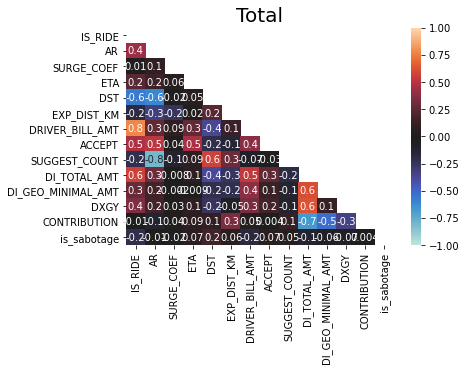

In [21]:
corr = df.corr(method = 'spearman')
matrix = np.triu(corr)
plt.title('Total', fontsize =20)
sns.heatmap(corr, annot = True, fmt='.1g', vmin=-1, vmax=1, center= 0, mask=matrix)

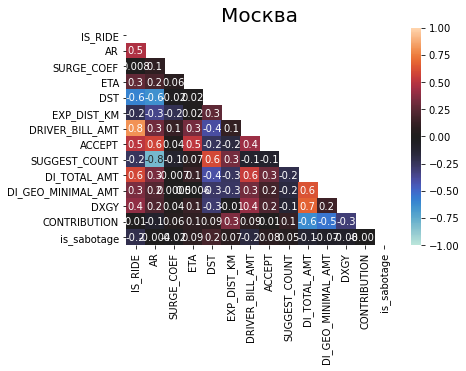

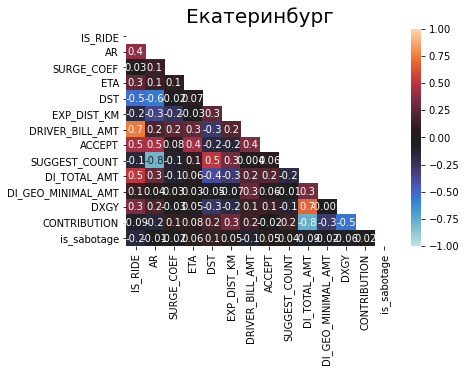

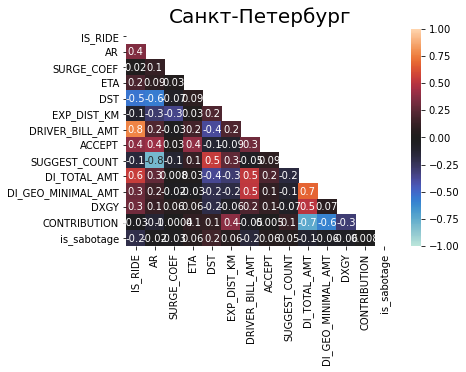

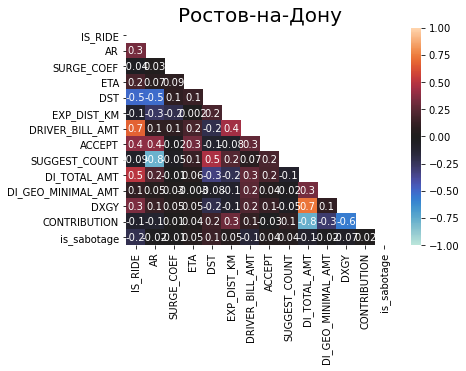

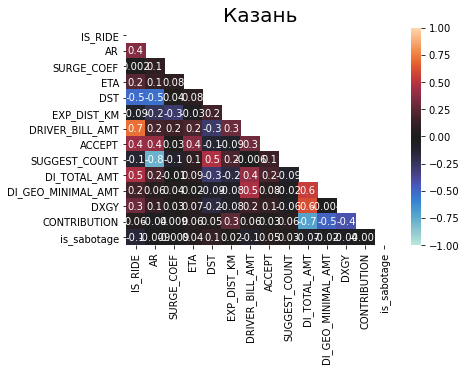

In [22]:
for locality in localities:
    
    data = df[df['LOCALITY_NM']==locality]
    
    corr = data.corr(method = 'spearman')
    matrix = np.triu(corr)
    plt.title(locality, fontsize =20)
    sns.heatmap(corr, annot = True, fmt='.1g', vmin=-1, vmax=1, center= 0, mask=matrix)
    plt.show()

<b>Только Driver Bill > 0 </b>

In [18]:
df_orders_dr_bill = df[df['DRIVER_BILL_AMT']>0]

<AxesSubplot:>

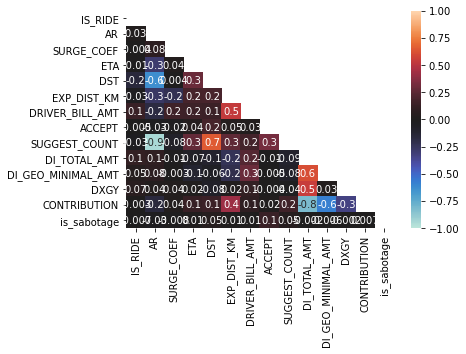

In [19]:
corr = df_orders_dr_bill.corr(method = 'spearman')
matrix = np.triu(corr)
sns.heatmap(corr, annot = True, fmt='.1g', vmin=-1, vmax=1, center= 0, mask=matrix)

# Регрессия

In [17]:
df_city = df[df['LOCALITY_NM']==localities[1]]

In [18]:
#a = df.SURGE_COEF
b = df.ETA
#c = df.DST
d = df.DRIVER_BILL_AMT
e = df.DI_TOTAL_AMT
#f = df.DI_GEO_MINIMAL_AMT
x = df.AR

# Fit the model
#model = sf.ols("x ~ a + b + c + d + e + f", df).fit()
model = sf.ols("x ~ d + e + b", df).fit()

# Print the summary
print(model.summary())

print("\nRetrieving manually the parameter estimates:")
print(model._results.params)

# Peform analysis of variance on fitted linear model
anova_results = anova_lm(model)

print('\nANOVA results')
print(anova_results)

plt.show()

                            OLS Regression Results                            
Dep. Variable:                      x   R-squared:                       0.058
Model:                            OLS   Adj. R-squared:                  0.058
Method:                 Least Squares   F-statistic:                 1.235e+05
Date:                Wed, 31 Mar 2021   Prob (F-statistic):               0.00
Time:                        10:45:13   Log-Likelihood:            -2.5332e+06
No. Observations:             5965413   AIC:                         5.066e+06
Df Residuals:                 5965409   BIC:                         5.066e+06
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.6005      0.000   2199.651      0.0

<b>Логистическая регрессия (ACCEPT 1/0)</b>

In [23]:
def is_surge(row):
    if row['SURGE_COEF'] > 10:
        return(1)
    else:
        return(0)

In [24]:
def is_accepted(row):
    if row['ACCEPT'] >= 1:
        return(1)
    else:
        return(0)

In [25]:
df['is_surge'] = df.apply(is_surge, axis=1)
df['is_accepted'] = df.apply(is_accepted, axis=1)

In [23]:
logit_res = sf.glm('is_accepted ~ C(is_surge) + ETA + DRIVER_BILL_AMT', df, family = sm.families.Binomial()).fit()

/Users/skostuchik/opt/anaconda3/lib/python3.8/site-packages/statsmodels/genmod/families/family.py:894: RuntimeWarning: divide by zero encountered in true_divide
  n_endog_mu = self._clean((1. - endog) / (1. - mu))
/Users/skostuchik/opt/anaconda3/lib/python3.8/site-packages/statsmodels/genmod/families/family.py:894: RuntimeWarning: invalid value encountered in true_divide
  n_endog_mu = self._clean((1. - endog) / (1. - mu))


KeyboardInterrupt: 

In [ ]:
logit_res.summary()

<b>AR в разных разрезах</b>

Наличие Surge:

In [24]:
df.head(3)

,LOCALITY_NM,IS_RIDE,AR,SURGE_COEF,ETA,DST,EXP_DIST_KM,DRIVER_BILL_AMT,ACCEPT,SUGGEST_COUNT,DI_TOTAL_AMT,DI_GEO_MINIMAL_AMT,DXGY,CONTRIBUTION,is_sabotage,is_surge,is_accepted
0,Казань,1,1.0,10.0,5,6,2,69,1,1,46.6667,0.0,25.9259,-27.83,0,0,1
1,Москва,1,0.5,10.0,10,106,3,400,1,2,291.0000,0.0,125.0000,-157.90,0,0,1
2,Москва,1,1.0,10.0,1,9,3,130,1,1,8.0000,8.0,0.0000,4.46,0,0,1


In [26]:
surge_ttl_suggests = df[['is_surge','ACCEPT','SUGGEST_COUNT']].groupby('is_surge').sum().reset_index()
surge_ttl_suggests['ar'] = np.divide(surge_ttl_suggests['ACCEPT'], surge_ttl_suggests['SUGGEST_COUNT'])

In [27]:
surge_ttl_suggests

,is_surge,ACCEPT,SUGGEST_COUNT,ar
0,0,2956716,7876956,0.375363
1,1,2648544,5363194,0.493837


In [28]:
surge_city_suggests = df[['LOCALITY_NM','is_surge','ACCEPT','SUGGEST_COUNT']].groupby(['LOCALITY_NM','is_surge']).sum().reset_index()
surge_city_suggests['ar'] = np.divide(surge_city_suggests['ACCEPT'], surge_city_suggests['SUGGEST_COUNT'])

In [29]:
surge_city_suggests

,LOCALITY_NM,is_surge,ACCEPT,SUGGEST_COUNT,ar
0,Екатеринбург,0,175325,420803,0.416644
1,Екатеринбург,1,208429,372444,0.559625
2,Казань,0,137055,256952,0.533388
3,Казань,1,182094,271996,0.669473
4,Москва,0,1690882,5174477,0.326774
5,Москва,1,1330551,3123076,0.426039
6,Ростов-на-Дону,0,231978,340561,0.681164
7,Ростов-на-Дону,1,100966,142339,0.709335
8,Санкт-Петербург,0,721476,1684163,0.428388
9,Санкт-Петербург,1,826504,1453339,0.568693


Наличие DI:

In [30]:
df['IS_DI'] = df['DI_TOTAL_AMT'].apply(lambda x: 1 if x > 0 else 0)

In [31]:
s_level_city = df[['LOCALITY_NM','IS_DI','ACCEPT','SUGGEST_COUNT']].groupby(['LOCALITY_NM','IS_DI']).sum().reset_index()
s_level_city['ar'] = np.divide(s_level_city['ACCEPT'], s_level_city['SUGGEST_COUNT'])

In [32]:
s_level_city

,LOCALITY_NM,IS_DI,ACCEPT,SUGGEST_COUNT,ar
0,Екатеринбург,0,176140,478868,0.367826
1,Екатеринбург,1,207614,314379,0.660394
2,Казань,0,155500,305363,0.509230
3,Казань,1,163649,223585,0.731932
4,Москва,0,1355215,5463888,0.248031
5,Москва,1,1666218,2833665,0.588008
6,Ростов-на-Дону,0,127692,218855,0.583455
7,Ростов-на-Дону,1,205252,264045,0.777337
8,Санкт-Петербург,0,713015,1854009,0.384580
9,Санкт-Петербург,1,834965,1283493,0.650541


In [33]:
s_level_all = df[['IS_DI','ACCEPT','SUGGEST_COUNT']].groupby('IS_DI').sum().reset_index()
s_level_all['ar'] = np.divide(s_level_all['ACCEPT'], s_level_all['SUGGEST_COUNT'])

In [34]:
s_level_all

,IS_DI,ACCEPT,SUGGEST_COUNT,ar
0,0,2527562,8320983,0.303758
1,1,3077698,4919167,0.625654


ETA для принятых и непринятых заказов:

In [35]:
eta_orders = df[['ACCEPT','SUGGEST_COUNT','ETA']]
eta_orders['AR'] = np.divide(eta_orders['ACCEPT'], eta_orders['SUGGEST_COUNT'])

eta_orders['AR_bins'] = eta_orders['AR'].apply(lambda x: round(x,1))

<ipython-input-35-714e1a3e0d59>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  eta_orders['AR'] = np.divide(eta_orders['ACCEPT'], eta_orders['SUGGEST_COUNT'])
<ipython-input-35-714e1a3e0d59>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  eta_orders['AR_bins'] = eta_orders['AR'].apply(lambda x: round(x,1))


In [36]:
eta_ar_bins = eta_orders[['AR_bins','ETA','ACCEPT']].groupby('AR_bins').agg({'ETA': 'mean', 'ACCEPT': 'count'}).reset_index()
eta_ar_bins.columns = ['AR','ETA','ORDER_QTY']
eta_ar_bins['ORDER_SHARE'] = np.divide(eta_ar_bins['ORDER_QTY'], eta_ar_bins['ORDER_QTY'].sum())

In [37]:
eta_ar_bins

,AR,ETA,ORDER_QTY,ORDER_SHARE
0,0.0,0.281219,695944,0.116659
1,0.1,7.707800,160048,0.026828
2,0.2,7.228635,301070,0.050467
3,0.3,6.784848,307387,0.051526
4,0.4,7.071085,15615,0.002617
5,0.5,6.126011,796218,0.133468
6,0.6,6.634495,2238,0.000375
7,0.7,6.161591,50702,0.008499
8,0.8,6.156772,3655,0.000613
9,0.9,5.555556,18,0.000003


<AxesSubplot:xlabel='ETA', ylabel='AR'>

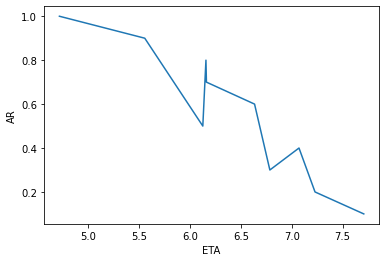

In [37]:
sns.lineplot(data=eta_ar_bins[eta_ar_bins['AR']>0], x="ETA", y="AR")

In [38]:
df[df['ACCEPT']==0][['ETA','ACCEPT']].groupby('ETA').count().reset_index()[:1]

,ETA,ACCEPT
0,0,670336


In [39]:
print(f'Доля заказов без единого Accept\'а в бине AR=0.0: {670336/695944}')

Доля заказов без единого Accept'а в бине AR=0.0: 0.9632039359488694



--==\\ Зависимость ETA и AR в городах //==--



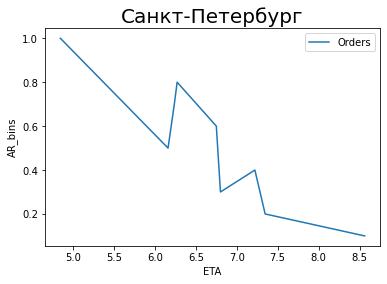

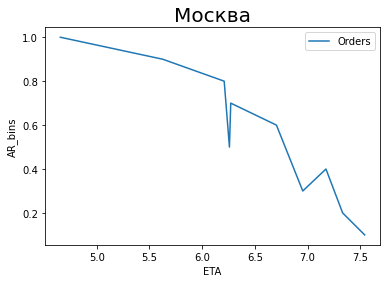

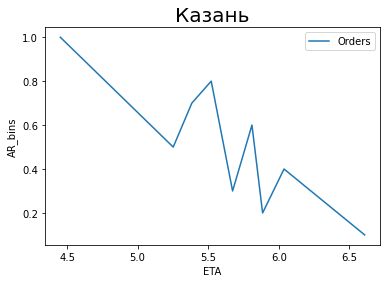

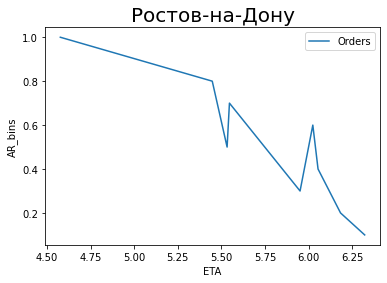

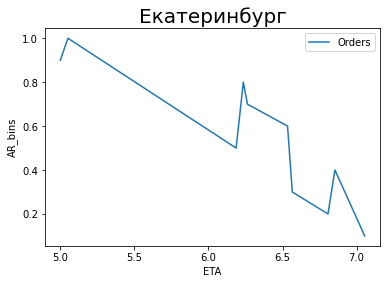

In [176]:
print('\n--==\\\ Зависимость ETA и AR в городах //==--\n')
for locality in localities:
    
    eta_orders_locality = df[df['LOCALITY_NM']==locality][['ACCEPT','SUGGEST_COUNT','ETA']]
    eta_orders_locality['AR'] = np.divide(eta_orders_locality['ACCEPT'], eta_orders_locality['SUGGEST_COUNT'])
    eta_orders_locality['AR_bins'] = eta_orders_locality['AR'].apply(lambda x: round(x,1))
    eta_orders_locality = eta_orders_locality[['AR_bins','ETA']].groupby('AR_bins').mean().reset_index()
    
    sns.lineplot(data=eta_orders_locality[eta_orders_locality['AR_bins']>0], x="ETA", y="AR_bins", label='Orders')
    plt.title(locality, fontsize =20)
    plt.legend()
    plt.show()

Саботаж

In [38]:
sabotage_orders = df[['is_sabotage','ACCEPT','SUGGEST_COUNT']].groupby('is_sabotage').sum().reset_index()
sabotage_orders['ar'] = np.divide(sabotage_orders['ACCEPT'], sabotage_orders['SUGGEST_COUNT'])

In [39]:
sabotage_orders[['is_sabotage','ar']]

,is_sabotage,ar
0,0,0.423578
1,1,0.413527


In [40]:
def get_bootstrap(
    data_column_1, # числовые значения первой выборки
    data_column_2, # числовые значения второй выборки
    boot_it = 1000, # количество бутстрэп-подвыборок
    statistic = np.mean, # интересующая нас статистика
    bootstrap_conf_level = 0.99 # уровень значимости
):
    boot_data = []
    for i in range(boot_it): # извлекаем подвыборки
#    for i in tqdm(range(boot_it)): # извлекаем подвыборки
        samples_1 = data_column_1.sample(
            len(data_column_1), 
            replace = True # параметр возвращения
        ).values
        
        samples_2 = data_column_2.sample(
            len(data_column_1), 
            replace = True
        ).values
        
        boot_data.append(statistic(samples_1)-statistic(samples_2)) # mean() - применяем статистику
        
    pd_boot_data = pd.DataFrame(boot_data)
        
    left_quant = (1 - bootstrap_conf_level)/2
    right_quant = 1 - (1 - bootstrap_conf_level) / 2
    quants = pd_boot_data.quantile([left_quant, right_quant])
        
    p_1 = norm.cdf(
        x = 0, 
        loc = np.mean(boot_data), 
        scale = np.std(boot_data)
    )
    p_2 = norm.cdf(
        x = 0, 
        loc = -np.mean(boot_data), 
        scale = np.std(boot_data)
    )
    p_value = min(p_1, p_2) * 2
       
    return {"boot_data": boot_data, 
            "quants": quants, 
            "p_value": p_value}

In [41]:
df['ar'] = np.divide(df['ACCEPT'], df['SUGGEST_COUNT'])

Проверяем bootstrap'ом

In [24]:
split_a = df[df['is_sabotage']==0]['ar'].sample(100000, replace=False)
split_b = df[df['is_sabotage']==1]['ar'].sample(100000, replace=False)

booted_data_ab = get_bootstrap(split_a, split_b)

In [25]:
booted_data_ab["p_value"]

2.3515576532463793e-48

In [26]:
booted_data_ab["quants"]

,0
0.005,0.018885
0.995,0.027004


# PCA

In [54]:
X, y = df.drop(['LOCALITY_NM','AR','SUGGEST_COUNT','is_surge','is_accepted','ACCEPT'], axis=1), df[['AR']]

In [55]:
# splitting our data into subsets (70 train /30 val split)

X_train, X_test, y_train, y_test =\
  train_test_split(X, y, 
                   #stratify=y, 
                   test_size=0.3, random_state=0)

# standardize our data using StandardScaler
# here we fit the PCAs using STANDARDIZED training data 
# (can be min/max or z-score standard scaler)

sc = StandardScaler()
X_train_std = sc.fit_transform(X_train)
X_test_std = sc.transform(X_test)

In [56]:
cov_mat = np.cov(X_train_std.T)

# From this covariance matrix, caluclate the Eigenvalues and the Eigenvectors
eigen_vals, eigen_vecs = np.linalg.eig(cov_mat)

pca = PCA()

# fit_transform() is used to calculate the PCAs from training data
X_train_pca = pca.fit_transform(X_train_std)

# to get the fit statistics (variance explained per component)
print("sklearn var:\n", pca.explained_variance_ratio_)
print("numpy var: \n", eigen_vals/sum(eigen_vals))

sklearn var:
 [0.36688948 0.13586036 0.11399635 0.11128879 0.10216501 0.08465596
 0.06094928 0.02012854 0.00406623]
numpy var: 
 [0.36688948 0.00406623 0.02012854 0.06094928 0.13586036 0.10216501
 0.11399635 0.11128879 0.08465596]


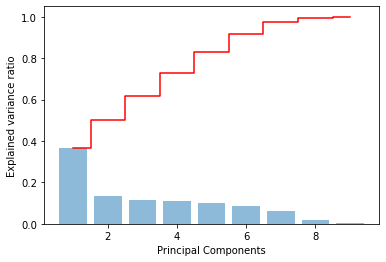

In [58]:
# like we did above visualize the PCs 
# and the cumulative variance explained by each PC

plt.bar(range(1,10), pca.explained_variance_ratio_,
        alpha=0.5,
        align='center')
plt.step(range(1,10), np.cumsum(pca.explained_variance_ratio_),
         where='mid',
         color='red')
plt.ylabel('Explained variance ratio')
plt.xlabel('Principal Components')
plt.show()

# Feature Importance

In [59]:
X, y = df.drop(['LOCALITY_NM','AR','SUGGEST_COUNT','DST','is_surge','is_accepted','ACCEPT'], axis=1), df['AR']

In [61]:
regr = RandomForestRegressor(max_depth=2, random_state=0)

In [62]:
regr.fit(X, y)

RandomForestRegressor(max_depth=2, random_state=0)

In [63]:
regr.feature_importances_

array([0.        , 0.80959015, 0.19040985, 0.        , 0.        ,
       0.        , 0.        , 0.        ])

In [64]:
X.head(0)

,SURGE_COEF,ETA,DRIVER_BILL_AMT,DI_TOTAL_AMT,DI_GEO_MINIMAL_AMT,DXGY,CONTRIBUTION,IS_DI


In [65]:
fi_data = dict(zip(X.columns,regr.feature_importances_))
fi_data = pd.DataFrame.from_dict(fi_data, orient='index', columns=['feature_importance'])

In [66]:
fi_data

,feature_importance
SURGE_COEF,0.00000
ETA,0.80959
DRIVER_BILL_AMT,0.19041
DI_TOTAL_AMT,0.00000
DI_GEO_MINIMAL_AMT,0.00000
DXGY,0.00000
CONTRIBUTION,0.00000
IS_DI,0.00000


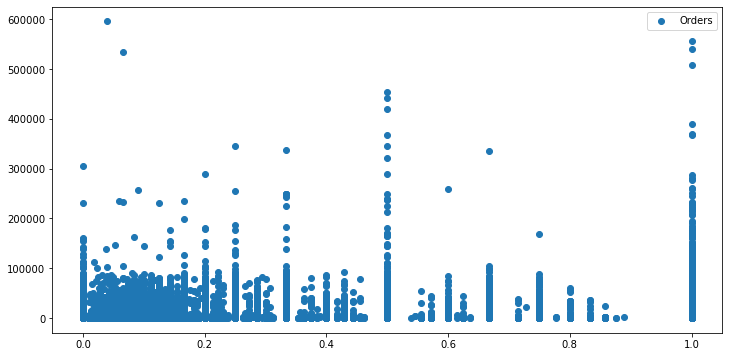

In [8]:
fig = plt.figure(figsize=(12, 6))
plt.scatter(df['AR'], df['DST'], label='Orders')
plt.legend()
plt.show()

# <font size="10" color="purple">В разрезе дней</font>

In [42]:
query_daily = '''
with s as (
    select
        s.id_order,
        sum(case when s."ACTION" in (1,-2) then 1 else 0 end) accept,
        sum(case when s."ACTION" in (-1,-3) then 1 else 0 end) "REJECT",
        sum(case when s."ACTION" in (0,-4,-5) then 1 else 0 end) fraud,
        count(s.id) suggest_count,
        local.accept / local.suggest_count ar
    from REPLICA.FAIRBOT_SUGGESTS_SUCCESS s
    where to_date(s.DATE_SUGGEST) between '2020-03-01' and '2021-02-28'
        and s.SUGGEST_TYPE = 4
    group by s.id_order),
dt_surge_koef as (
    select
        opc.ID_ORDER_FINAL
        , max(opc.COEFFICIENT) coef
    from replica.ORDER_PRICE_CALCULATIONS opc
    where opc.G_TYPE is null /*исключаем тестовые заказы*/
        and to_date(opc.PRICE_TIME) between '2020-03-01' and '2021-02-28'
    group by opc.ID_ORDER_FINAL) /*убираем косяки, когда для одлного заказа два разных коэффициента*/
SELECT
       o.LOCALITY_NM,
       to_date(o.LOCAL_ORDER_DTTM) dt,
       SUM(s.accept)/SUM(s.suggest_count) ar,
       AVG(CASE
           WHEN o.STATUS_CD = 'CC' THEN SECONDS_BETWEEN(OCI.DATE_CLOSED, o.ORDER_DTTM)
           WHEN o.STATUS_CD = 'CP' THEN SECONDS_BETWEEN(OCI.DRIVERASSIGNED, o.ORDER_DTTM)
           END) DST,
       AVG(oci.ASSIGN_DURATION) ETA,
       (count(o.ORDER_RK) - sum(case when o.STATUS_CD = 'CP' THEN 1 ELSE 0 END))/count(o.ORDER_RK) cc_share,
       sum(case when o.STATUS_CD = 'CP' THEN 1 ELSE 0 END)/count(o.ORDER_RK) o2r,
       sum(case when o.STATUS_CD = 'CP' THEN 1 ELSE 0 END)/SUM(s.suggest_count) OF2R,
       AVG(NVL(sf.coef, 10.0)) surge_coef,
       SUM(ZEROIFNULL(ic.DI_TOTAL_AMT))/COUNT(ZEROIFNULL(ic.DI_TOTAL_AMT)) DI_P_TRIP,
       SUM(ZEROIFNULL(ic.DI_TOTAL_AMT)) DI_TOTAL_AMT,
       SUM(ZEROIFNULL(ic.DI_GEO_MINIMAL_AMT))/COUNT(ZEROIFNULL(ic.DI_GEO_MINIMAL_AMT)) DI_GEO_P_TRIP,
       SUM(ZEROIFNULL(ic.DI_GEO_MINIMAL_AMT)) DI_GEO_MINIMAL_AMT,
       SUM(ZEROIFNULL(ic.DI_MAIN_DXGY + ic.DI_WELCOME_DXGY + ic.DI_POWER_DXGY + ic.DI_OTHER_DXGY))/COUNT(ZEROIFNULL(ic.DI_MAIN_DXGY + ic.DI_WELCOME_DXGY + ic.DI_POWER_DXGY + ic.DI_OTHER_DXGY)) DXGY_P_TRIP,
       SUM(ZEROIFNULL(ic.DI_MAIN_DXGY + ic.DI_WELCOME_DXGY + ic.DI_POWER_DXGY + ic.DI_OTHER_DXGY)) DXGY_AMT,
       SUM(ZEROIFNULL(ic.COMMISSION_TOTAL_AMT - ic.DI_TOTAL_AMT - ic.CI_TOTAL_AMT)) contribution,
       MEDIAN(o.DRIVER_BILL_AMT) DRIVER_BILL_P_TRIP
FROM EMART."ORDER" o
LEFT JOIN REPLICA.ORDER_CLOSED_INFO oci ON O.ORDER_RK = OCI.ID
LEFT JOIN s on s.ID_ORDER = o.ORDER_RK
LEFT JOIN REPLICA_MART.INCENTIVE_COMISSION ic on ic.ORDER_ID = o.ORDER_RK
LEFT JOIN dt_surge_koef sf on sf.ID_ORDER_FINAL = o.ORDER_RK
WHERE to_date(o.LOCAL_ORDER_DTTM) between '2020-03-01' and '2021-02-28'
    and o.order_company_rk = 1
    and o.STATUS_CD in ('CP', 'CC')
    and o.LOCALITY_NM in ('Москва','Санкт-Петербург','Ростов-на-Дону','Екатеринбург','Казань')
    and s.id_order is not null
GROUP BY 1, 2
'''

In [43]:
stm_daily = cnn.execute(query_daily)

In [44]:
df_daily = pd.DataFrame(stm_daily.fetchall())

In [45]:
df_daily['AR'] = df_daily['AR'].astype(float)
df_daily['DST'] = df_daily['DST'].astype(float)
df_daily['ETA'] = df_daily['ETA'].astype(float)
df_daily['CC_SHARE'] = df_daily['CC_SHARE'].astype(float)
df_daily['O2R'] = df_daily['O2R'].astype(float)
df_daily['OF2R'] = df_daily['OF2R'].astype(float)
df_daily['SURGE_COEF'] = df_daily['SURGE_COEF'].astype(float)
df_daily['DI_P_TRIP'] = df_daily['DI_P_TRIP'].astype(float)
df_daily['DI_TOTAL_AMT'] = df_daily['DI_TOTAL_AMT'].astype(float)
df_daily['DI_GEO_P_TRIP'] = df_daily['DI_GEO_P_TRIP'].astype(float)
df_daily['DI_GEO_MINIMAL_AMT'] = df_daily['DI_GEO_MINIMAL_AMT'].astype(float)
df_daily['DXGY_P_TRIP'] = df_daily['DXGY_P_TRIP'].astype(float)
df_daily['DXGY_AMT'] = df_daily['DXGY_AMT'].astype(float)
df_daily['CONTRIBUTION'] = df_daily['CONTRIBUTION'].astype(float)
df_daily['DRIVER_BILL_P_TRIP'] = df_daily['DRIVER_BILL_P_TRIP'].astype(float)

In [60]:
df_daily.profile_report()

# Корреляции

<AxesSubplot:>

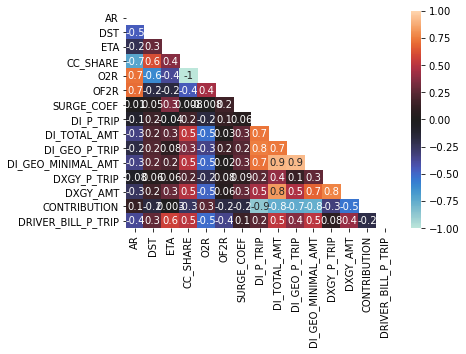

In [9]:
corr = df_daily.corr(method = 'spearman')
matrix = np.triu(corr)
sns.heatmap(corr, annot = True, fmt='.1g', vmin=-1, vmax=1, center= 0, mask=matrix)

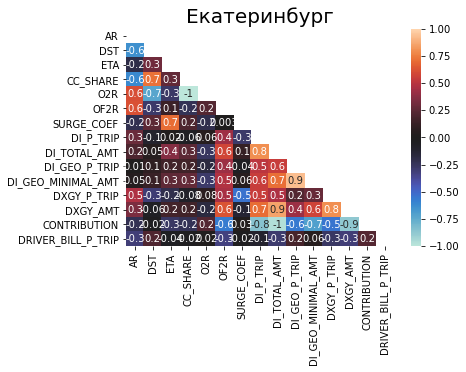

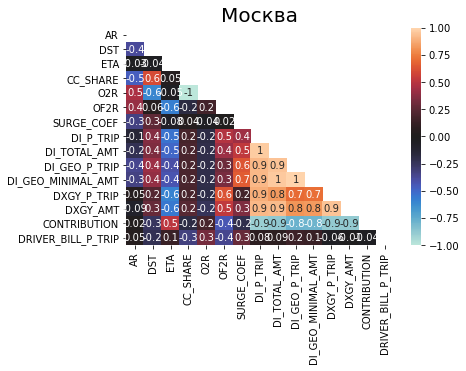

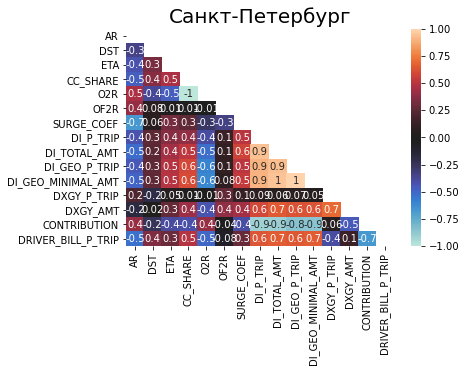

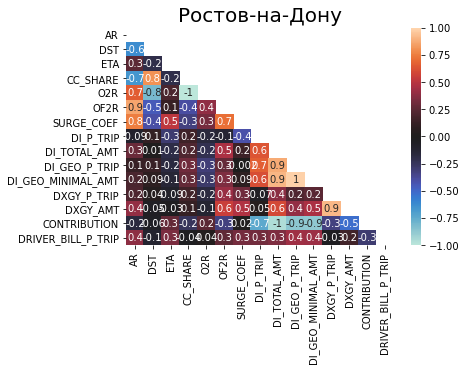

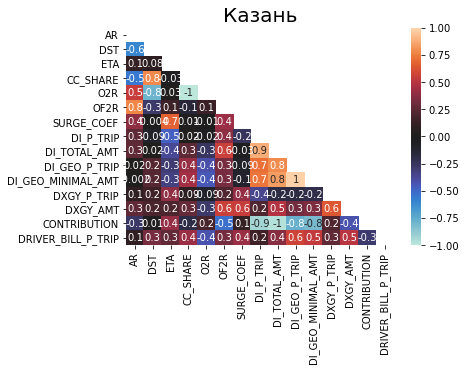

In [22]:
for locality in localities:
    data = df_daily[df_daily['LOCALITY_NM']==locality]
    corr = data.corr(method = 'spearman')
    matrix = np.triu(corr)
    plt.title(locality, fontsize =20)
    sns.heatmap(corr, annot = True, fmt='.1g', vmin=-1, vmax=1, center= 0, mask=matrix)
    plt.show()

Корреляции коэффициента surge'а и AR в разных городах

In [26]:
r_localities = {}

for locality in localities:
    r = spearmanr(df_daily[df_daily['LOCALITY_NM']==locality]['AR'],
                  df_daily[df_daily['LOCALITY_NM']==locality]['SURGE_COEF'])
    r_localities.update({locality:{'correlation':r[0], 'pvalue':r[1]}})
    
r_localities = pd.DataFrame.from_dict(r_localities).T

In [27]:
r_localities

,correlation,pvalue
Екатеринбург,-0.211370,4.692423e-05
Москва,-0.329515,1.082553e-10
Санкт-Петербург,-0.668314,1.414340e-48
Ростов-на-Дону,0.757427,3.431748e-69
Казань,0.388146,1.428088e-14


In [28]:
spearmanr(df_daily['AR'], df_daily['SURGE_COEF'])

SpearmanrResult(correlation=0.009983405231543266, pvalue=0.6699550720111412)

# Регрессия

In [ ]:
df_daily.head(1)

In [ ]:
#df_daily_city = df_daily[df_daily['LOCALITY_NM']==localities[1]]
#print(df_daily_cilty.LOCALITY_NM.unique())

a = df_daily.DST
b = df_daily.ETA
c = df_daily.O2R
d = df_daily.SURGE_COEF
e = df_daily.DI_P_TRIP
f = df_daily.DRIVER_BILL_P_TRIP

x = df_daily.AR

# Fit the model
#model = sf.ols("x ~ c", df_daily).fit()
model = sf.ols("x ~ c", df_daily).fit()
#model = sf.ols("x ~ a + b + c + d + e + f", df_daily).fit()

# Print the summary
print(model.summary())

print("\nRetrieving manually the parameter estimates:")
print(model._results.params)

# Peform analysis of variance on fitted linear model
anova_results = anova_lm(model)

print('\nANOVA results')
print(anova_results)

plt.show()

# Feature Importance

In [ ]:
df_daily.head(0)

In [ ]:
X, y = df_daily.drop(['LOCALITY_NM','DT','AR','CC_SHARE','O2R','DST','CONTRIBUTION'], axis=1), df_daily['AR']

In [ ]:
regr = RandomForestRegressor(max_depth=2, random_state=0)

In [ ]:
regr.fit(X, y)

In [ ]:
fi_data = dict(zip(X.columns,regr.feature_importances_))
fi_data = pd.DataFrame.from_dict(fi_data, orient='index', columns=['feature_importance'])

In [ ]:
fi_data

# <b>Зависимость AR и O2R</b>

In [46]:
fig = px.scatter(df_daily, x="AR", y="O2R", trendline="ols")
fig.show()

То же в разрезе городов:

In [47]:
for locality in localities:
    fig = px.scatter(df_daily[df_daily['LOCALITY_NM']==locality], x="AR", y="O2R", trendline="ols", title=locality)
    fig.show()

In [25]:
df_daily.head()

,LOCALITY_NM,DT,AR,DST,ETA,CC_SHARE,O2R,OF2R,SURGE_COEF,DI_P_TRIP,DI_TOTAL_AMT,DI_GEO_P_TRIP,DI_GEO_MINIMAL_AMT,DXGY_P_TRIP,DXGY_AMT,CONTRIBUTION,DRIVER_BILL_P_TRIP
0,Москва,2020-05-11,0.535016,236.720389,5.217569,0.257451,0.742549,0.150177,10.0,10.650534,292687.3191,0.292748,8045.0,5.955014,163649.7498,1.067010e+06,221.0
1,Ростов-на-Дону,2020-07-19,0.399122,280.373245,3.933136,0.348953,0.651047,0.345402,10.0,31.747696,644319.4964,2.354718,47789.0,5.682896,115334.3739,-3.607130e+05,96.0
2,Казань,2020-06-14,0.680629,146.691026,3.879869,0.188675,0.811325,0.579963,10.0,31.206862,743472.2733,0.000000,0.0,22.910900,545829.2851,-3.537587e+05,105.0
3,Москва,2020-05-12,0.488163,171.560440,5.431504,0.288711,0.711289,0.167585,10.0,11.700270,363071.0936,0.258355,8017.0,7.010774,217551.3156,9.868846e+05,200.0
4,Ростов-на-Дону,2020-03-23,0.583516,160.887733,4.557434,0.195925,0.804075,0.238892,10.0,51.029472,117724.9919,4.500217,10382.0,0.000000,0.0000,-8.771695e+04,175.0


In [29]:
spearmanr(df_daily['AR'], df_daily['O2R'])

SpearmanrResult(correlation=0.7264263612388994, pvalue=2.908804153380863e-299)

# <font size="10" color="purple">В разрезе водителей</font>

In [48]:
query_drivers = '''
with s as (
    select
        s.id_order,
        sum(case when s."ACTION" in (1,-2) then 1 else 0 end) accept,
        sum(case when s."ACTION" in (-1,-3) then 1 else 0 end) "REJECT",
        sum(case when s."ACTION" in (0,-4,-5) then 1 else 0 end) fraud,
        count(s.id) suggest_count
    from REPLICA.FAIRBOT_SUGGESTS_SUCCESS s
    where to_date(s.DATE_SUGGEST) between '2020-03-01' and '2021-02-28'
        and s.SUGGEST_TYPE = 4
    group by s.id_order)
select o.LOCALITY_NM, o.DRIVER_RK,
       sum(s.accept) accept, sum(s.suggest_count) suggest_count,
       sum(s.accept) / sum(s.suggest_count) ar,
       sum(case when o.STATUS_CD='CP' then 1 else 0 end) trips,
       local.trips / count(distinct to_date(o.LOCAL_ORDER_DTTM)) trips_daily,
       sum(o.DRIVER_BILL_AMT) DRIVER_BILL_AMT,
       median(o.DRIVER_BILL_AMT) DRIVER_BILL_MEDIAN,
       sum(ZEROIFNULL(ic.DI_TOTAL_AMT)) DI_TOTAL_AMT,
       CASE WHEN local.trips = 0
        THEN 0 ELSE local.DI_TOTAL_AMT / local.trips END DI_P_TRIP,
           sum(ZEROIFNULL(ic.DRIVER_BILL_AMT)+ZEROIFNULL(ic.DI_MAIN_DXGY)+ZEROIFNULL(ic.DI_OTHER_DXGY)+
            ZEROIFNULL(ic.DI_POWER_DXGY)+ZEROIFNULL(ic.DI_WELCOME_DXGY)-ZEROIFNULL(ic.COMMISSION_TOTAL_AMT)) /
            count(distinct to_date(o.LOCAL_ORDER_DTTM)) avg_daily_income
FROM EMART."ORDER" o
LEFT JOIN s on s.ID_ORDER = o.ORDER_RK
LEFT JOIN REPLICA_MART.INCENTIVE_COMISSION ic on ic.ORDER_ID = o.ORDER_RK
WHERE to_date(o.LOCAL_ORDER_DTTM) between '2020-03-01' and '2021-02-28'
    and o.order_company_rk = 1
    and o.STATUS_CD in ('CP', 'CC')
    and o.LOCALITY_NM in ('Москва','Санкт-Петербург','Ростов-на-Дону','Екатеринбург','Казань')
    and s.id_order is not null
    and o.DRIVER_RK is not null
group by 1, 2
'''

In [49]:
stm_drivers = cnn.execute(query_drivers)

In [50]:
df_drivers = pd.DataFrame(stm_drivers.fetchall())

In [51]:
df_drivers['DRIVER_RK'] = df_drivers['DRIVER_RK'].astype(int)
df_drivers['ACCEPT'] = df_drivers['ACCEPT'].astype(int)
df_drivers['SUGGEST_COUNT'] = df_drivers['SUGGEST_COUNT'].astype(int)
df_drivers['AR'] = df_drivers['AR'].astype(float)
df_drivers['TRIPS'] = df_drivers['TRIPS'].astype(float)
df_drivers['TRIPS_DAILY'] = df_drivers['TRIPS_DAILY'].astype(float)
df_drivers['DRIVER_BILL_AMT'] = df_drivers['DRIVER_BILL_AMT'].astype(float)
df_drivers['DRIVER_BILL_MEDIAN'] = df_drivers['DRIVER_BILL_MEDIAN'].astype(float)
df_drivers['DI_TOTAL_AMT'] = df_drivers['DI_TOTAL_AMT'].astype(float)
df_drivers['DI_P_TRIP'] = df_drivers['DI_P_TRIP'].astype(float)
df_drivers['AVG_DAILY_INCOME'] = df_drivers['AVG_DAILY_INCOME'].astype(float)

In [88]:
df_drivers.profile_report()

In [52]:
query_antifraud = '''
SELECT DHR.ID_DRIVER DRIVER_RK, 1 is_antifraud
FROM (
         (SELECT ID_REVISION
          FROM EXA_DB.REPLICA.DRIVERS_HISTORY_NEW
          WHERE FIELD = 'block_reason'
            AND "BEFORE" IN ('38'))
    UNION
         (SELECT ID_REVISION
          FROM EXA_DB.REPLICA.DRIVERS_HISTORY_NEW
          WHERE FIELD = 'block_reason'
            AND "AFTER" IN ('38'))

         ) DHN
         INNER JOIN (SELECT ID
                          , ID_DRIVER
                          , DATE_ADD
                     FROM EXA_DB.REPLICA.DRIVERS_HISTORY_REVISION
    ) as DHR ON DHN.ID_REVISION = TO_NUMBER(DHR.ID)
'''

In [53]:
stm_antifraud = cnn.execute(query_antifraud)

In [54]:
drivers_antifraud = pd.DataFrame(stm_antifraud.fetchall())

In [55]:
drivers_antifraud = drivers_antifraud.groupby('DRIVER_RK').mean().reset_index()

In [56]:
df_drivers = df_drivers.merge(drivers_antifraud, how='left', on='DRIVER_RK')
df_drivers['IS_ANTIFRAUD'].fillna(0.0, inplace=True)

# Корреляции

<AxesSubplot:>

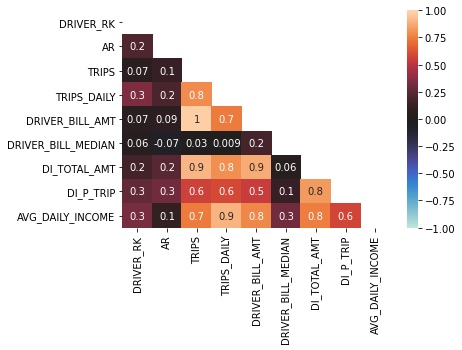

In [90]:
corr = df_drivers.corr(method = 'spearman')
matrix = np.triu(corr)
sns.heatmap(corr, annot = True, fmt='.1g', vmin=-1, vmax=1, center= 0, mask=matrix)

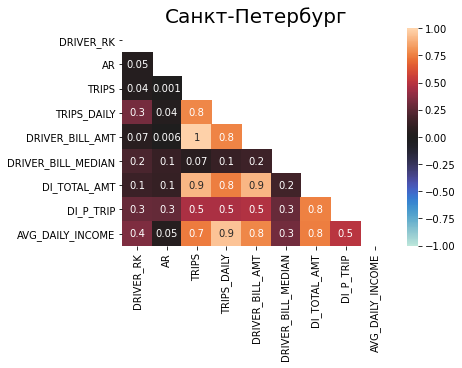

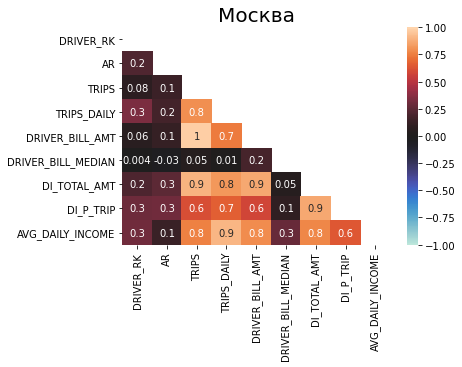

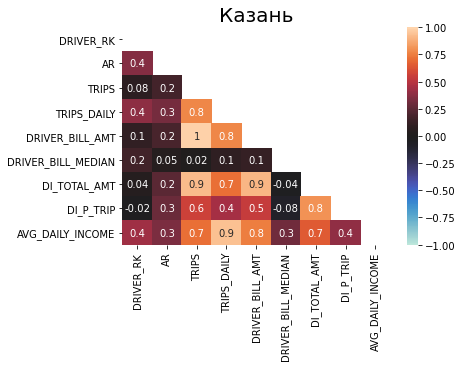

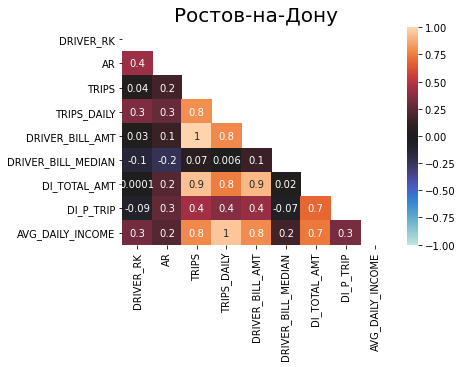

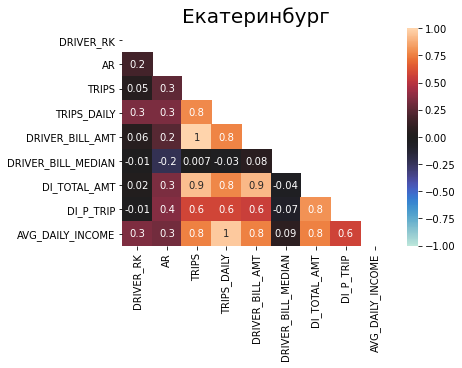

In [192]:
for locality in localities:
    data = df_drivers[df_drivers['LOCALITY_NM']==locality]
    corr = data.corr(method = 'spearman')
    matrix = np.triu(corr)
    plt.title(locality, fontsize =20)
    sns.heatmap(corr, annot = True, fmt='.1g', vmin=-1, vmax=1, center= 0, mask=matrix)
    plt.show()

# Регрессия

In [96]:
a = df_drivers.TRIPS_DAILY
b = df_drivers.DRIVER_BILL_AMT
c = df_drivers.AVG_DAILY_INCOME

x = df_drivers.AR

# Fit the model
#model = sf.ols("x ~ c", df_daily).fit()
model = sf.ols("x ~ a + b + c", df_drivers).fit()
#model = sf.ols("x ~ a + b + c + d + e + f", df_daily).fit()

# Print the summary
print(model.summary())

print("\nRetrieving manually the parameter estimates:")
print(model._results.params)

# Peform analysis of variance on fitted linear model
anova_results = anova_lm(model)

print('\nANOVA results')
print(anova_results)

plt.show()

                            OLS Regression Results                            
Dep. Variable:                      x   R-squared:                       0.043
Model:                            OLS   Adj. R-squared:                  0.043
Method:                 Least Squares   F-statistic:                     5772.
Date:                Wed, 31 Mar 2021   Prob (F-statistic):               0.00
Time:                        11:37:08   Log-Likelihood:                 25002.
No. Observations:              383911   AIC:                        -5.000e+04
Df Residuals:                  383907   BIC:                        -4.995e+04
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.4935      0.001    909.725      0.0

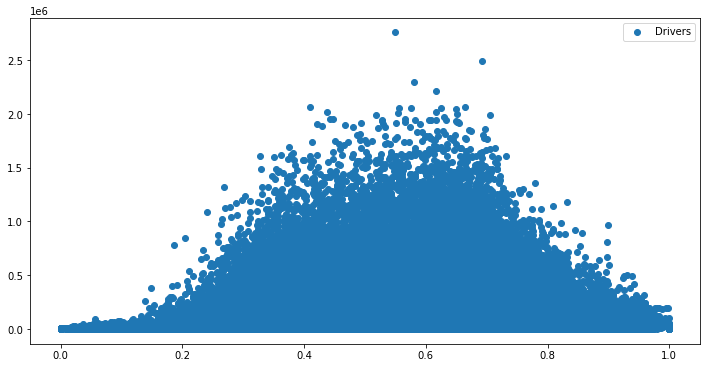

In [97]:
fig = plt.figure(figsize=(12, 6))
plt.scatter(df_drivers['AR'], df_drivers['DRIVER_BILL_AMT'], label='Drivers')
plt.legend()
plt.show()

# Feature Importance

In [98]:
X, y = df_drivers.drop(['LOCALITY_NM','DRIVER_RK','AR','TRIPS_DAILY','DRIVER_BILL_MEDIAN','DI_P_TRIP'], axis=1), df_drivers['AR']

In [99]:
regr = RandomForestRegressor(max_depth=2, random_state=0)

In [100]:
regr.fit(X, y)

RandomForestRegressor(max_depth=2, random_state=0)

In [101]:
fi_data = dict(zip(X.columns,regr.feature_importances_))
fi_data = pd.DataFrame.from_dict(fi_data, orient='index', columns=['feature_importance'])

In [102]:
fi_data

,feature_importance
TRIPS,0.126287
DRIVER_BILL_AMT,0.020787
DI_TOTAL_AMT,0.852926
AVG_DAILY_INCOME,0.000000


# <font size="10" color="purple">Churn</font>

В разрезе suggest'ов:

In [97]:
querry_churn_s = '''
--suggest level
with lo as (
    select o.DRIVER_RK, max(o.LOCAL_ORDER_DTTM) last_order
    from EMART."ORDER" o
    where o.STATUS_CD = 'CP'
        and to_date(o.LOCAL_ORDER_DTTM) >= '2021-02-01'
    group by o.DRIVER_RK),
s as (
    select s.ID, s.ID_DRIVER, to_date(lo.last_order) last_order,
        case when s."ACTION" in (1,-2) then 1 else 0 end accept,
        s.DURATION
    from REPLICA.FAIRBOT_SUGGESTS_SUCCESS s
    join lo on lo.DRIVER_RK = s.ID_DRIVER
    where to_date(s.DATE_SUGGEST) >= to_date(lo.last_order) - INTERVAL '1' MONTH)
select s.ID,
       case when s.last_order < current_date-14 then 1 else 0 end is_churned,
       s.accept, s.DURATION/60 eta
from s
'''

In [98]:
stm_churn_s = cnn.execute(querry_churn_s)

In [99]:
churn_s = pd.DataFrame(stm_churn_s.fetchall())

In [100]:
churn_s['IS_CHURNED'] = churn_s['IS_CHURNED'].astype(int)
churn_s['ACCEPT'] = churn_s['ACCEPT'].astype(int)
churn_s['ETA'] = churn_s['ETA'].astype(float)

In [93]:
a_s = len(churn_s[(churn_s['IS_CHURNED'] == 0)&(churn_s['ACCEPT'] > 0)])
a_f = len(churn_s[(churn_s['IS_CHURNED'] == 0)&(churn_s['ACCEPT'] == 0)])
b_s = len(churn_s[(churn_s['IS_CHURNED'] == 1)&(churn_s['ACCEPT'] > 0)])
b_f = len(churn_s[(churn_s['IS_CHURNED'] == 1)&(churn_s['ACCEPT'] == 0)])

#делим на 100, потму что chi2_contingency ломается
a_s, a_f, b_s, b_f = int(a_s/100), int(a_f/100), int(b_s/100), int(b_f/100)

successes = [a_s, b_s]
fails = [a_f, b_f]

p_val = chi2_contingency(np.array([fails, successes]))[1]

In [94]:
a = churn_s[churn_s['IS_CHURNED']==0]['ACCEPT'].sum()/len(churn_s[churn_s['IS_CHURNED']==0])
b = churn_s[churn_s['IS_CHURNED']==1]['ACCEPT'].sum()/len(churn_s[churn_s['IS_CHURNED']==1])

lift = (b-a)/abs(a)

a_nobs = len(churn_s[churn_s['IS_CHURNED']==0])
b_nobs = len(churn_s[churn_s['IS_CHURNED']==1])
nobs_diff_value = (b_nobs-a_nobs)/abs(a_nobs)

In [95]:
alpha = 0.01
power = 0.9
n_bins = 2

probs0, probs1 = np.array([a_s, a_f]), np.array([b_s, b_f])

effect_size = chisquare_effectsize(probs0, probs1, correction=None, cohen=True, axis=0)

res = int(GofChisquarePower().solve_power(effect_size=effect_size, alpha=alpha, power=power, n_bins=n_bins))

mde_marker_value = np.nan

if (a_nobs>=res)&(b_nobs>=res):
    mde_marker_value = 1
else:
    mde_marker_value = mde_marker_value

In [96]:
print(f'lift: {lift}, p_val: {p_val}, \nMDE_OK: {mde_marker_value}, \na: {a}, b: {b}, a_n_obs: {a_nobs}, b_n_obs: {b_nobs}')

lift: -0.036696303823876876, p_val: 3.44495499343398e-49, 
MDE_OK: 1, 
a: 0.4989740282454711, b: 0.48066352570475157, a_n_obs: 46083140, b_n_obs: 25001895


<b>Logistic Regression</b>

In [ ]:
logit_res = sf.glm('IS_CHURNED ~ C(ACCEPT)', churn_s, family = sm.families.Binomial()).fit()

In [163]:
logit_res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:             IS_CHURNED   No. Observations:             61224863
Model:                            GLM   Df Residuals:                 61224861
Model Family:                Binomial   Df Model:                            1
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:            -3.6261e+07
Date:                Tue, 30 Mar 2021   Deviance:                   7.2522e+07
Time:                        20:18:37   Pearson chi2:                 6.12e+07
No. Iterations:                     9                                         
Covariance Type:            nonrobust                                         
==================================================================================
                     coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------
Intercept         -0.9134      0.000  -2311.411      0.000      -0.914      -0.913
C(ACCEPT)[T.1]    -0.0703      0.001   -123.313      0.000      -0.071      -0.069
==================================================================================
"""

# Комменты

кажется стоит ещё глянуть это влияние AR на заработок водителя. Можно ли увидеть связь между низким AR водителя и supply hours, mph 

In [150]:
query_c1 = '''
with o as (
    select
        o.DRIVER_RK, count(o.ORDER_RK) trips,
           sum(ic.DRIVER_BILL_AMT) DRIVER_BILL_AMT,
           SUM(DI_WELCOME_DXGY+DI_POWER_DXGY+DI_OTHER_DXGY+DI_MAIN_DXGY+DI_MFG) DI
    from EMART."ORDER" o
    LEFT JOIN REPLICA_MART.INCENTIVE_COMISSION ic on ic.ORDER_ID = o.ORDER_RK and ic.DRIVER_ID = o.DRIVER_RK
    WHERE to_date(o.LOCAL_ORDER_DTTM) between '2021-02-21' and '2021-03-22'
        AND o.STATUS_CD = 'CP'
        and o.DRIVER_RK is not null
    group by 1),
s as (
    select s.ID_DRIVER, count(s.ID) suggests, sum(case when s."ACTION" in (1,-2) then 1 else 0 end) accept
    from REPLICA.FAIRBOT_SUGGESTS_SUCCESS s
    where to_date(s.DATE_SUGGEST) between '2021-02-21' and '2021-03-22'
        and s.SUGGEST_TYPE = 4
    group by 1)
select o.DRIVER_RK, l.SHORT_NAME locality,
       s.accept / s.suggests ar,
       o.trips, o.DRIVER_BILL_AMT + o.DI daily_income
from o
join replica.DRIVERS d on d.ID = o.DRIVER_RK
left join md.LOCALITY l on l.LOCALITY_RK = d.ID_LOCALITY
left join s on s.ID_DRIVER = o.DRIVER_RK
'''

In [151]:
stm_query_c1 = cnn.execute(query_c1)

In [152]:
df_c1 = pd.DataFrame(stm_query_c1.fetchall())

In [153]:
query_ch_c1 = '''
select dsd.driver_id, MAX(dsd.locality_id) locality_id, MAX(dsd.locality_nm) locality_nm, SUM(dsd.sh / (3600)) sh
from sandbox.driver_sh_daily dsd
group by dsd.driver_id
'''

In [154]:
df_ch_c1 = clickhouse.fetch(query_ch_c1)

In [155]:
df_c1

,DRIVER_RK,LOCALITY,AR,TRIPS,DAILY_INCOME
0,21174547,Москва,NaN,2,856
1,22671491,Санкт-Петербург,NaN,2,880
2,12941226,Новосибирск,NaN,1,213
3,20760151,Новосибирск,NaN,1,175
4,22673603,Москва,0.753086,47,14886
...,...,...,...,...,...
161291,23082775,Екатеринбург,NaN,4,19840
161292,11699722,Санкт-Петербург,NaN,1,356
161293,15211642,Пермь,NaN,9,3643
161294,23265887,Москва,NaN,4,4559


In [156]:
data_c1 = df_c1.merge(df_ch_c1, how='left', left_on='DRIVER_RK', right_on='driver_id')

In [157]:
print('Missed data',round(len(data_c1[data_c1['sh'].isna()])/len(data_c1),3),'%')

Missed data 0.016 %


In [158]:
data_c1 = data_c1[~data_c1['sh'].isna()]
data_c1 = data_c1[~data_c1['AR'].isna()]
data_c1 = data_c1[~data_c1['DAILY_INCOME'].isna()]
data_c1 = data_c1[data_c1['sh'] > 0]

In [159]:
data_c1 = data_c1[['DRIVER_RK','LOCALITY','AR','TRIPS','DAILY_INCOME','sh']]

In [160]:
data_c1['DRIVER_RK'] = data_c1['DRIVER_RK'].astype(int)
data_c1['AR'] = data_c1['AR'].astype(float)
data_c1['TRIPS'] = data_c1['TRIPS'].astype(int)
data_c1['DAILY_INCOME'] = data_c1['DAILY_INCOME'].astype(float)
data_c1['sh'] = data_c1['sh'].astype(float)

In [168]:
data_c1['MPH'] = np.divide(data_c1['DAILY_INCOME'], data_c1['sh'])
data_c1['TPH'] = np.divide(data_c1['TRIPS'], data_c1['sh'])
data_c1['AR_bins'] = data_c1['AR'].apply(lambda x: round(x * 20) / 20)

In [169]:
data_c1.head()

,DRIVER_RK,LOCALITY,AR,TRIPS,DAILY_INCOME,sh,MPH,TPH,AR_bins
4,22673603,Москва,0.753086,47,14886.0000,7.673889,1939.824803,6.124665,0.75
5,20932079,Уфа,0.625000,23,5282.0000,7.542778,700.272520,3.049275,0.60
6,21169367,Москва,0.459215,231,121995.0006,144.965556,841.544739,1.593482,0.45
7,22807879,Екатеринбург,0.156250,4,760.0000,2.076111,366.069039,1.926679,0.15
8,21554851,Санкт-Петербург,0.421429,187,68832.0000,81.510833,844.452169,2.294174,0.40


In [181]:
all_localities = data_c1[['LOCALITY','DRIVER_RK']].groupby('LOCALITY').count().sort_values(by='DRIVER_RK', ascending=False).index

In [183]:
mph_tph_ar_bins = data_c1[['AR_bins','MPH','TPH','sh','TRIPS','DRIVER_RK']].groupby('AR_bins').agg({'MPH': 'median', 'TPH': 'median', 'sh': 'median', 'TRIPS': 'mean', 'DRIVER_RK': 'nunique'}).reset_index()
mph_tph_ar_bins.columns = ['AR','MPH','TPH','sh','TRIPS','DRIVERS']

In [184]:
mph_tph_ar_bins

,AR,MPH,TPH,sh,TRIPS,DRIVERS
0,0.00,218.214075,0.535117,4.115278,4.218289,339
1,0.05,256.025911,0.608109,7.538472,17.164735,1208
2,0.10,409.450014,1.113622,8.950694,51.628205,2730
3,0.15,444.292233,1.231764,7.930972,48.934236,3102
4,0.20,482.712898,1.300868,7.718056,44.814614,4051
5,0.25,524.635035,1.427445,12.057778,60.748144,5388
6,0.30,589.321594,1.525833,19.147500,83.585330,6721
7,0.35,603.489413,1.601049,22.157778,95.215680,9936
8,0.40,611.313507,1.681498,31.445833,113.225978,11656
9,0.45,588.993223,1.805014,36.051667,128.193645,12683


In [173]:
fig = px.line(x=mph_tph_ar_bins[mph_tph_ar_bins['DRIVERS']>500]['AR'],
              y=mph_tph_ar_bins[mph_tph_ar_bins['DRIVERS']>500]['MPH'],
              labels={'x':'AR', 'y':'MPH'})
fig.show()

In [182]:
for locality in all_localities:
    d = data_c1[data_c1['LOCALITY']==locality][['AR_bins','MPH','TPH','sh','TRIPS','DRIVER_RK']].groupby('AR_bins').agg({'MPH': 'median', 'TPH': 'median', 'sh': 'median', 'TRIPS': 'mean', 'DRIVER_RK': 'count'}).reset_index()
    d.columns = ['AR','MPH','TPH','sh','TRIPS','DRIVERS']
    
    fig = px.line(x=d['AR'], y=d['MPH'],
                  labels={'x':'AR', 'y':'MPH'}, title=locality)
    fig.show()

Запрос Ларри

In [145]:
larry_q = '''
WITH SUGGESTS AS
    (
        SELECT ID_ORDER ORDER_RK,
               SUM(CASE WHEN F.ACTION IN (1,-2,3,4) THEN 1 END) AS ACCEPT,
               COUNT(F.ID) AS COUNT_SUGGEST
        FROM REPLICA.FAIRBOT_SUGGESTS_SUCCESS F
        WHERE to_date(DATE_SUGGEST) between '2021-02-21' and '2021-03-22'
        GROUP BY ID_ORDER
    )
SELECT AR,
       ROUND(MEDIAN(MPH)) MPH,
       ROUND(MEDIAN(TPH),1) TPH,
       ROUND(AVG(RIDES)) RIDES,
       COUNT(*) DRIVERS
FROM (
SELECT O.DRIVER_RK,
       ROUND(ROUND(SUM(CASE WHEN STATUS_CD = 'CP' THEN COMMISSION_TOTAL_AMT-DI_TOTAL_AMT-CI_TOTAL_AMT ELSE 0 END)
           /SUM(CASE WHEN STATUS_CD = 'CP' THEN O.DRIVER_BILL_AMT ELSE 0 END),2)*100/5)*5 CONT_GMV,
       ROUND(ROUND(SUM(ACCEPT)/SUM(COUNT_SUGGEST)/5,2)*5,2) AR,
       SUM(CASE WHEN STATUS_CD = 'CP' THEN O.DRIVER_BILL_AMT+DI_MFG+DI_OTHER_DXGY+DI_MAIN_DXGY ELSE 0 END)/SUM(TOTAL_SUPPLY_SEC)*3600 MPH,
       SUM(STATUS_CD='CP')/SUM(TOTAL_SUPPLY_SEC)*3600 TPH,
       SUM(STATUS_CD='CP') RIDES
FROM EMART."ORDER" O
LEFT JOIN REPLICA_MART.INCENTIVE_COMISSION OI ON O.ORDER_RK = OI.ORDER_ID
LEFT JOIN REPLICA_MART.DRIVERS_SH_ORDERLY SH ON O.ORDER_RK = SH.ORDER_RK
LEFT JOIN SUGGESTS S ON O.ORDER_RK = S.ORDER_RK
WHERE to_date(O.ORDER_DTTM) between '2021-02-21' and '2021-03-22'
AND REGION='Москва'
GROUP BY 1
HAVING SUM(CASE WHEN STATUS_CD = 'CP' THEN O.DRIVER_BILL_AMT ELSE 0 END)>0 AND SUM(STATUS_CD='CP')>5
)
GROUP BY 1
HAVING COUNT(*)>500
ORDER BY 1
'''

In [146]:
stm_larry_q = cnn.execute(larry_q)

In [147]:
larry_df = pd.DataFrame(stm_larry_q.fetchall())

In [186]:
larry_df

,AR,MPH,TPH,RIDES,DRIVERS
0,0.25,697.0,1.2,42.0,877
1,0.30,686.0,1.2,54.0,1604
2,0.35,683.0,1.3,71.0,1969
3,0.40,687.0,1.3,79.0,2419
4,0.45,714.0,1.3,88.0,2530
5,0.50,731.0,1.4,101.0,2891
6,0.55,743.0,1.4,116.0,3227
7,0.60,767.0,1.4,128.0,3337
8,0.65,760.0,1.4,131.0,3330
9,0.70,707.0,1.3,113.0,2476


In [149]:
fig = px.line(x=larry_df['AR'], y=larry_df['MPH'], labels={'x':'AR', 'y':'MPH'})
fig.show()

переделываем через таблицу REPLICA_MART.DRIVER_MOVING_AGG_DAILY

In [134]:
larry_dmad = '''
WITH S AS
    (
        SELECT ID_ORDER ORDER_RK,
               SUM(CASE WHEN F.ACTION IN (1,-2) THEN 1 END) AS ACCEPT,
               COUNT(F.ID) AS COUNT_SUGGEST
        FROM REPLICA.FAIRBOT_SUGGESTS_SUCCESS F
        WHERE to_date(DATE_SUGGEST) between '2021-02-21' and '2021-03-22'
        GROUP BY ID_ORDER
    ),
sh as (
    SELECT dmad.DRIVER_RK, SUM(dmad.DRIVER_STAY_DUR_SEC)/3600 sh
    FROM REPLICA_MART.DRIVER_MOVING_AGG_DAILY dmad
    where BUSINESS_DT between '2021-02-21' and '2021-03-22'
        and dmad.DRIVER_ROBOT_CD in (2,3,4)
        and STATE_TCD > 1
    group by 1)
SELECT O.DRIVER_RK,
       SUM(ACCEPT)/SUM(COUNT_SUGGEST) AR,
       SUM(CASE WHEN STATUS_CD = 'CP' THEN O.DRIVER_BILL_AMT+DI_MFG+DI_OTHER_DXGY+DI_MAIN_DXGY ELSE 0 END)/SUM(sh.sh) MPH,
       SUM(STATUS_CD='CP')/SUM(sh.sh) TPH,
       SUM(STATUS_CD='CP') RIDES
FROM EMART."ORDER" O
LEFT JOIN REPLICA_MART.INCENTIVE_COMISSION OI ON O.ORDER_RK = OI.ORDER_ID
LEFT JOIN sh on sh.DRIVER_RK = O.DRIVER_RK
LEFT JOIN S ON O.ORDER_RK = S.ORDER_RK
WHERE to_date(O.ORDER_DTTM) between '2021-02-21' and '2021-03-22'
AND REGION='Москва'
AND STATUS_CD = 'CP'
AND sh.sh > 0
GROUP BY 1
'''

In [135]:
stm_larry_dmad = cnn.execute(larry_dmad)

In [136]:
larry_dmad_df = pd.DataFrame(stm_larry_dmad.fetchall())

In [137]:
larry_dmad_df

,DRIVER_RK,AR,MPH,TPH,RIDES
0,13417194,0.560000,15.591876,0.039721,13
1,22583759,0.223140,19.497620,0.034127,26
2,23220647,0.625000,22.081777,0.060575,15
3,20089247,0.653846,57.227013,0.087453,16
4,22321747,0.458716,18.447906,0.057167,50
...,...,...,...,...,...
40517,22282091,0.851064,13.041641,0.019634,77
40518,16983891,0.412698,39.069126,0.058049,24
40519,12861914,0.649798,3.912628,0.007664,298
40520,22689183,1.000000,193.614595,0.684151,2


In [138]:
larry_dmad_df['AR_bins'] = larry_dmad_df['AR'].apply(lambda x: round(x,1))

In [139]:
larry_dmad_df[['AR_bins','MPH','TPH','RIDES','DRIVER_RK']].groupby('AR_bins').agg({'MPH': 'median', 'TPH': 'median', 'RIDES': 'mean', 'DRIVER_RK': 'count'}).reset_index()

,AR_bins,MPH,TPH,RIDES,DRIVER_RK
0,0.0,479.266977,0.526799,1.500000,44
1,0.1,153.352219,0.230814,4.957075,629
2,0.2,58.793419,0.105346,15.230384,1797
3,0.3,23.564984,0.043337,41.513869,3425
4,0.4,14.821469,0.027741,68.229683,4885
5,0.5,16.843960,0.033307,78.687695,6404
6,0.6,12.244010,0.023335,113.105546,6708
7,0.7,15.243976,0.028212,112.903333,6300
8,0.8,39.659684,0.077379,58.815669,3727
9,0.9,64.876526,0.130182,35.745259,1582


In [190]:
qqq = '''
SELECT dmad.DRIVER_RK, SUM(dmad.DRIVER_STAY_DUR_SEC)/3600 sh
FROM REPLICA_MART.DRIVER_MOVING_AGG_DAILY dmad
where BUSINESS_DT between '2021-02-21' and '2021-03-22'
and STATE_TCD > 0
group by 1
'''

In [191]:
stm_qqq = cnn.execute(qqq)

In [192]:
qqq_df = pd.DataFrame(stm_qqq.fetchall())

In [193]:
qqq_df

,DRIVER_RK,SH
0,22180415,6.600556
1,11591886,17.449444
2,13417194,49.521944
3,12305186,0.001944
4,18075055,32.638611
...,...,...
222686,18553187,16.339444
222687,18173815,0.408611
222688,22871971,161.138889
222689,11020938,116.181111


In [199]:
qqq_test = data_c1.merge(qqq_df, how='left', on='DRIVER_RK')
qqq_test['delta'] = qqq_test['SH'] / qqq_test['sh']

In [200]:
qqq_test.sort_values(by='delta', ascending=False)

,DRIVER_RK,LOCALITY,AR,TRIPS,DAILY_INCOME,sh,MPH,TPH,AR_bins,SH,delta
143334,21229299,Санкт-Петербург,0.648438,144,48137.9995,0.000278,1.732968e+08,518400.000000,0.65,104.657222,376766.000000
75351,20093931,Санкт-Петербург,0.804511,93,27463.0007,0.000278,9.886680e+07,334800.000000,0.80,56.984722,205145.000000
93968,22601271,Москва,0.573171,43,11174.0000,0.000278,4.022640e+07,154800.000000,0.55,47.116111,169618.000000
11442,18083623,Санкт-Петербург,0.887097,52,18140.9993,0.000278,6.530760e+07,187200.000000,0.90,44.026111,158494.000000
125242,18931935,Санкт-Петербург,0.606667,80,24846.0001,0.000556,4.472280e+07,144000.000000,0.60,81.069167,145924.500000
...,...,...,...,...,...,...,...,...,...,...,...
33795,23292827,Москва,1.000000,1,222.0000,0.828333,2.680080e+02,1.207243,1.00,0.416389,0.502683
13455,23048155,Москва,1.000000,2,540.0000,2.146111,2.516179e+02,0.931918,1.00,1.078611,0.502589
130185,23292987,Москва,0.333333,1,500.0000,1.307222,3.824904e+02,0.764981,0.35,0.655556,0.501487
8330,23298623,Москва,1.000000,1,400.0000,0.459444,8.706167e+02,2.176542,1.00,0.229722,0.500000


<AxesSubplot:>

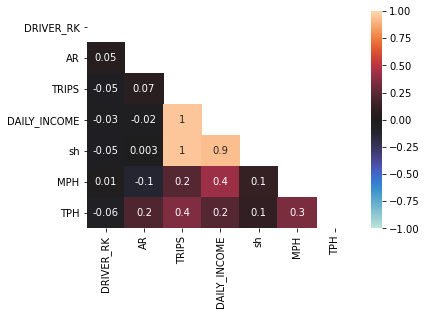

In [59]:
corr = data_c1.corr(method = 'spearman')
matrix = np.triu(corr)
sns.heatmap(corr, annot = True, fmt='.1g', vmin=-1, vmax=1, center= 0, mask=matrix)

In [60]:
a = data_c1.TRIPS
b = data_c1.DAILY_INCOME
c = data_c1.sh
d = data_c1.MPH

x = data_c1.AR

# Fit the model
model = sf.ols("x ~ a + b + c + d", data_c1).fit()

# Print the summary
print(model.summary())

print("\nRetrieving manually the parameter estimates:")
print(model._results.params)

# Peform analysis of variance on fitted linear model
anova_results = anova_lm(model)

print('\nANOVA results')
print(anova_results)

plt.show()

                            OLS Regression Results                            
Dep. Variable:                      x   R-squared:                       0.026
Model:                            OLS   Adj. R-squared:                  0.026
Method:                 Least Squares   F-statistic:                     1057.
Date:                Sun, 25 Apr 2021   Prob (F-statistic):               0.00
Time:                        22:30:53   Log-Likelihood:                 14573.
No. Observations:              158302   AIC:                        -2.914e+04
Df Residuals:                  158297   BIC:                        -2.909e+04
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.5597      0.001    789.755      0.0

Feature Importance

In [61]:
X, y = data_c1[['DAILY_INCOME','sh','MPH']], data_c1['AR']

In [62]:
regr = RandomForestRegressor(max_depth=2, random_state=0)

In [63]:
regr.fit(X, y)

RandomForestRegressor(max_depth=2, random_state=0)

In [64]:
fi_data = dict(zip(X.columns,regr.feature_importances_))
fi_data = pd.DataFrame.from_dict(fi_data, orient='index', columns=['feature_importance'])

In [65]:
fi_data

,feature_importance
DAILY_INCOME,0.0
sh,0.0
MPH,1.0


ETA и AR без портовых заказов и подач по цепочке

In [6]:
query_orders_i = '''
with s as (
    select
        s.id_order,
        sum(case when s."ACTION" in (1,-2) then 1 else 0 end) accept,
        sum(case when s."ACTION" in (-1,-3) then 1 else 0 end) "REJECT",
        sum(case when s."ACTION" in (0,-4,-5) then 1 else 0 end) fraud,
        count(s.id) suggest_count,
        local.accept / local.suggest_count ar
    from REPLICA.FAIRBOT_SUGGESTS_SUCCESS s
    where to_date(s.DATE_SUGGEST) between '2021-02-01' and '2021-02-14'
        and s.SUGGEST_TYPE = 4
        and s.IS_CHAIN_SUGGEST = 0
    group by s.id_order),
dt_surge_koef as (
    select
        opc.ID_ORDER_FINAL
        , max(opc.COEFFICIENT) as coef
    from replica.ORDER_PRICE_CALCULATIONS opc
    where opc.G_TYPE is null /*исключаем тестовые заказы*/
        and PRICE_TIME between '2021-02-01' and '2021-02-14'
    group by opc.ID_ORDER_FINAL) /*убираем косяки, когда для одлного заказа два разных коэффициента*/
SELECT
       o.LOCALITY_NM,
       o.ORDER_RK,
       o.STATUS_CD,
       CASE WHEN o.STATUS_CD = 'CP' THEN 1 ELSE 0 END is_ride,
       s.ar,
       sf.coef surge_coef,
       oci.ASSIGN_DURATION ETA,
       CASE
           WHEN o.STATUS_CD = 'CC' THEN SECONDS_BETWEEN(OCI.DATE_CLOSED, o.ORDER_DTTM)
           WHEN o.STATUS_CD = 'CP' THEN SECONDS_BETWEEN(OCI.DRIVERASSIGNED, o.ORDER_DTTM)
           END DST,
       o.DRIVER_BILL_AMT,
       s.accept,
       s.suggest_count,
       ZEROIFNULL(ic.DI_TOTAL_AMT) DI_TOTAL_AMT,
       ZEROIFNULL(ic.DI_GEO_MINIMAL_AMT) DI_GEO_MINIMAL_AMT,
       ZEROIFNULL(ic.DI_MAIN_DXGY + ic.DI_WELCOME_DXGY + ic.DI_POWER_DXGY + ic.DI_OTHER_DXGY) DXGY,
       ZEROIFNULL(ic.COMMISSION_TOTAL_AMT - ic.DI_TOTAL_AMT - ic.CI_TOTAL_AMT) contribution
FROM EMART."ORDER" o
LEFT JOIN REPLICA.ORDER_CLOSED_INFO oci ON O.ORDER_RK = OCI.ID
LEFT JOIN s on s.ID_ORDER = o.ORDER_RK
LEFT JOIN REPLICA_MART.INCENTIVE_COMISSION ic on ic.ORDER_ID = o.ORDER_RK
LEFT JOIN dt_surge_koef sf on sf.ID_ORDER_FINAL = o.ORDER_RK
WHERE o.ORDER_DTTM between '2021-02-01' and '2021-02-14'
    and o.order_company_rk = 1
    and o.STATUS_CD in ('CP', 'CC')
    and o.LOCALITY_NM in ('Москва','Санкт-Петербург','Ростов-на-Дону','Екатеринбург','Казань')
    and s.id_order is not null
    and o.AIRPORT_TYPE_NM != 'Departure point'
'''

In [7]:
stm_qi = cnn.execute(query_orders_i)

In [8]:
df_qi = pd.DataFrame(stm_qi.fetchall())

In [9]:
df_qi.head()

,LOCALITY_NM,ORDER_RK,STATUS_CD,IS_RIDE,AR,SURGE_COEF,ETA,DST,DRIVER_BILL_AMT,ACCEPT,SUGGEST_COUNT,DI_TOTAL_AMT,DI_GEO_MINIMAL_AMT,DXGY,CONTRIBUTION
0,Санкт-Петербург,1822716387,CC,0,1.000000,13,6,369,0,1,1,0,0,0,0
1,Москва,1821510875,CP,1,0.333333,10,9,153,200,1,3,110,0,85,-83.4667
2,Ростов-на-Дону,1812507363,CP,1,0.333333,10,5,72,134,1,3,51.4231,0,26.9231,-30.8227
3,Москва,1812248443,CP,1,0.166667,10,8,67,504,1,6,0,0,0,96.768
4,Москва,1822729891,CP,1,0.166667,12,13,42,527,1,6,0,0,0,88.536


In [10]:
df_qi['SURGE_COEF'].fillna(10, inplace=True)
df_qi['DST'].fillna(0, inplace=True)

df_qi['ORDER_RK'] = df_qi['ORDER_RK'].astype(int)
df_qi['IS_RIDE'] = df_qi['IS_RIDE'].astype(int)
df_qi['AR'] = df_qi['AR'].astype(float)
df_qi['SURGE_COEF'] = df_qi['SURGE_COEF'].astype(float)
df_qi['ETA'] = df_qi['ETA'].astype(int)
df_qi['DST'] = df_qi['DST'].astype(int)
df_qi['DRIVER_BILL_AMT'] = df_qi['DRIVER_BILL_AMT'].astype(int)
df_qi['ACCEPT'] = df_qi['ACCEPT'].astype(int)
df_qi['SUGGEST_COUNT'] = df_qi['SUGGEST_COUNT'].astype(int)
df_qi['DI_TOTAL_AMT'] = df_qi['DI_TOTAL_AMT'].astype(float)
df_qi['DI_GEO_MINIMAL_AMT'] = df_qi['DI_GEO_MINIMAL_AMT'].astype(float)
df_qi['DXGY'] = df_qi['DXGY'].astype(float)
df_qi['CONTRIBUTION'] = df_qi['CONTRIBUTION'].astype(float)

In [177]:
eta_orders_qi = df_qi[['ACCEPT','SUGGEST_COUNT','ETA']]
eta_orders_qi['AR'] = np.divide(eta_orders_qi['ACCEPT'], eta_orders_qi['SUGGEST_COUNT'])

eta_orders_qi['AR_bins'] = eta_orders_qi['AR'].apply(lambda x: round(x,1))

<ipython-input-177-12fe067bdb11>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  eta_orders_qi['AR'] = np.divide(eta_orders_qi['ACCEPT'], eta_orders_qi['SUGGEST_COUNT'])
<ipython-input-177-12fe067bdb11>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  eta_orders_qi['AR_bins'] = eta_orders_qi['AR'].apply(lambda x: round(x,1))


In [178]:
eta_ar_bins_qi = eta_orders_qi[['AR_bins','ETA','ACCEPT']].groupby('AR_bins').agg({'ETA': 'mean', 'ACCEPT': 'count'}).reset_index()
eta_ar_bins_qi.columns = ['AR','ETA','ORDER_QTY']
eta_ar_bins_qi['ORDER_SHARE'] = np.divide(eta_ar_bins_qi['ORDER_QTY'], eta_ar_bins_qi['ORDER_QTY'].sum())

In [180]:
eta_ar_bins_qi

,AR,ETA,ORDER_QTY,ORDER_SHARE
0,0.0,1.401150,842561,0.160804
1,0.1,8.382627,114558,0.021864
2,0.2,7.875083,211389,0.040344
3,0.3,7.349782,217953,0.041597
4,0.4,7.529059,10324,0.001970
5,0.5,6.539899,598827,0.114287
6,0.6,7.019481,1540,0.000294
7,0.7,6.516703,35951,0.006861
8,0.8,6.472797,2610,0.000498
9,0.9,6.294118,17,0.000003


<AxesSubplot:xlabel='ETA', ylabel='AR'>

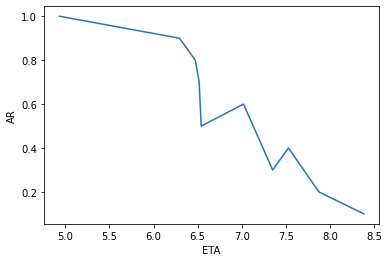

In [181]:
sns.lineplot(data=eta_ar_bins_qi[eta_ar_bins_qi['AR']>0], x="ETA", y="AR")

In [191]:
len(df),len(df_qi), len(df_qi)/len(df)-1

(5965623, 5239679, -0.12168787736000075)

DST + ETA vs. AR

In [11]:
df_qi['DST_min'] = np.divide(df_qi['DST'], 60)

In [12]:
df_qi['dst_eta'] = np.add(df_qi['DST_min'], df_qi['ETA'])

In [13]:
df_qi.head()

,LOCALITY_NM,ORDER_RK,STATUS_CD,IS_RIDE,AR,SURGE_COEF,ETA,DST,DRIVER_BILL_AMT,ACCEPT,SUGGEST_COUNT,DI_TOTAL_AMT,DI_GEO_MINIMAL_AMT,DXGY,CONTRIBUTION,DST_min,dst_eta
0,Санкт-Петербург,1822716387,CC,0,1.000000,13.0,6,369,0,1,1,0.0000,0.0,0.0000,0.0000,6.150000,12.150000
1,Москва,1821510875,CP,1,0.333333,10.0,9,153,200,1,3,110.0000,0.0,85.0000,-83.4667,2.550000,11.550000
2,Ростов-на-Дону,1812507363,CP,1,0.333333,10.0,5,72,134,1,3,51.4231,0.0,26.9231,-30.8227,1.200000,6.200000
3,Москва,1812248443,CP,1,0.166667,10.0,8,67,504,1,6,0.0000,0.0,0.0000,96.7680,1.116667,9.116667
4,Москва,1822729891,CP,1,0.166667,12.0,13,42,527,1,6,0.0000,0.0,0.0000,88.5360,0.700000,13.700000


In [204]:
eta_orders_ed = df_qi[['ACCEPT','SUGGEST_COUNT','dst_eta']]
eta_orders_ed['AR'] = np.divide(eta_orders_ed['ACCEPT'], eta_orders_ed['SUGGEST_COUNT'])

eta_orders_ed['AR_bins'] = eta_orders_ed['AR'].apply(lambda x: round(x,1))

<ipython-input-204-05639c72f213>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  eta_orders_ed['AR'] = np.divide(eta_orders_ed['ACCEPT'], eta_orders_ed['SUGGEST_COUNT'])
<ipython-input-204-05639c72f213>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  eta_orders_ed['AR_bins'] = eta_orders_ed['AR'].apply(lambda x: round(x,1))


In [205]:
eta_orders_ed

,ACCEPT,SUGGEST_COUNT,dst_eta,AR,AR_bins
0,1,1,12,1.000000,1.0
1,1,1,9,1.000000,1.0
2,1,1,2,1.000000,1.0
3,1,1,4,1.000000,1.0
4,0,1,4,0.000000,0.0
...,...,...,...,...,...
5239674,1,3,12,0.333333,0.3
5239675,1,1,1,1.000000,1.0
5239676,1,1,8,1.000000,1.0
5239677,1,1,5,1.000000,1.0


In [206]:
eta_ar_bins_ed = eta_orders_ed[['AR_bins','dst_eta','ACCEPT']].groupby('AR_bins').agg({'dst_eta': 'mean', 'ACCEPT': 'count'}).reset_index()
eta_ar_bins_ed.columns = ['AR','dst_eta','ORDER_QTY']
eta_ar_bins_ed['ORDER_SHARE'] = np.divide(eta_ar_bins_ed['ORDER_QTY'], eta_ar_bins_ed['ORDER_QTY'].sum())

In [213]:
eta_ar_bins_ed.sort_values(by='dst_eta')

,AR,dst_eta,ORDER_QTY,ORDER_SHARE
10,1.0,7.138545,3203949,0.611478
0,0.0,7.831907,842561,0.160804
5,0.5,10.388140,598827,0.114287
3,0.3,13.052511,217953,0.041597
7,0.7,15.175239,35951,0.006861
2,0.2,15.515391,211389,0.040344
1,0.1,19.603118,114558,0.021864
4,0.4,23.271503,10324,0.001970
6,0.6,31.227922,1540,0.000294
8,0.8,35.103065,2610,0.000498


<AxesSubplot:xlabel='dst_eta', ylabel='AR'>

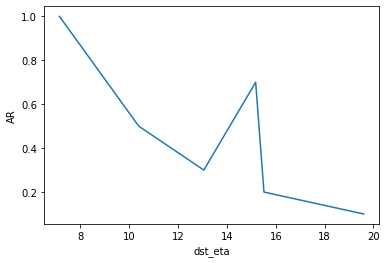

In [214]:
sns.lineplot(data=eta_ar_bins_ed[(eta_ar_bins_ed['AR']>0)&(eta_ar_bins_ed['dst_eta']<20)], x="dst_eta", y="AR")

Клиентские отмены vs. ETA

In [14]:
df_qi.head()

,LOCALITY_NM,ORDER_RK,STATUS_CD,IS_RIDE,AR,SURGE_COEF,ETA,DST,DRIVER_BILL_AMT,ACCEPT,SUGGEST_COUNT,DI_TOTAL_AMT,DI_GEO_MINIMAL_AMT,DXGY,CONTRIBUTION,DST_min,dst_eta
0,Санкт-Петербург,1822716387,CC,0,1.000000,13.0,6,369,0,1,1,0.0000,0.0,0.0000,0.0000,6.150000,12.150000
1,Москва,1821510875,CP,1,0.333333,10.0,9,153,200,1,3,110.0000,0.0,85.0000,-83.4667,2.550000,11.550000
2,Ростов-на-Дону,1812507363,CP,1,0.333333,10.0,5,72,134,1,3,51.4231,0.0,26.9231,-30.8227,1.200000,6.200000
3,Москва,1812248443,CP,1,0.166667,10.0,8,67,504,1,6,0.0000,0.0,0.0000,96.7680,1.116667,9.116667
4,Москва,1822729891,CP,1,0.166667,12.0,13,42,527,1,6,0.0000,0.0,0.0000,88.5360,0.700000,13.700000


In [15]:
df_qi['client_cancellation'] = df_qi['STATUS_CD'].apply(lambda x: 1 if x=='CC' else 0)

In [22]:
cc_eta = df_qi[df_qi['ETA']!=0][['client_cancellation','ORDER_RK','ETA']].groupby('ETA').agg({'client_cancellation': 'sum', 'ORDER_RK': 'count'}).reset_index()

In [27]:
cc_eta = cc_eta[cc_eta['ORDER_RK']>50]

In [29]:
cc_eta['cc_share'] = np.divide(cc_eta['client_cancellation'], cc_eta['ORDER_RK'])

<ipython-input-29-1969ccd7a237>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cc_eta['cc_share'] = np.divide(cc_eta['client_cancellation'], cc_eta['ORDER_RK'])


<AxesSubplot:xlabel='ETA', ylabel='cc_share'>

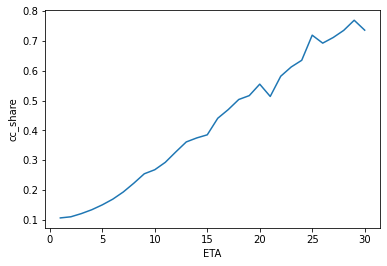

In [31]:
sns.lineplot(data=cc_eta, x="ETA", y="cc_share")

AR у водителей-саботажников

In [74]:
df_drivers.head()

,LOCALITY_NM,DRIVER_RK,ACCEPT,SUGGEST_COUNT,AR,TRIPS,TRIPS_DAILY,DRIVER_BILL_AMT,DRIVER_BILL_MEDIAN,DI_TOTAL_AMT,DI_P_TRIP,AVG_DAILY_INCOME,IS_ANTIFRAUD
0,Санкт-Петербург,19250583,406,654,0.620795,329.0,10.612903,95641.0,250.0,30506.5659,92.725124,2425.168710,0.0
1,Санкт-Петербург,20846423,29,35,0.828571,26.0,4.333333,9208.0,302.0,650.8969,25.034496,1177.794667,0.0
2,Москва,20587855,156,406,0.384236,135.0,13.500000,60960.0,335.0,14526.9409,107.606970,5621.127980,0.0
3,Санкт-Петербург,16566159,1,1,1.000000,0.0,0.000000,0.0,0.0,0.0000,0.000000,0.000000,0.0
4,Санкт-Петербург,15771551,15,26,0.576923,11.0,1.222222,2345.0,170.0,696.9323,63.357482,220.027900,1.0


In [77]:
drivers_fraud_ar = df_drivers[['IS_ANTIFRAUD','ACCEPT','SUGGEST_COUNT','AR']].groupby('IS_ANTIFRAUD').agg({'ACCEPT': 'sum', 'SUGGEST_COUNT': 'sum', 'AR': 'mean'}).reset_index()

In [78]:
drivers_fraud_ar['xAR'] = np.divide(drivers_fraud_ar['ACCEPT'], drivers_fraud_ar['SUGGEST_COUNT'])

In [79]:
drivers_fraud_ar

,IS_ANTIFRAUD,ACCEPT,SUGGEST_COUNT,AR,xAR
0,0.0,73329939,139091020,0.525835,0.527208
1,1.0,36649158,63249350,0.571218,0.579439


In [80]:
df_drivers[['IS_ANTIFRAUD','ACCEPT','SUGGEST_COUNT','AR']]

,IS_ANTIFRAUD,ACCEPT,SUGGEST_COUNT,AR
0,0.0,406,654,0.620795
1,0.0,29,35,0.828571
2,0.0,156,406,0.384236
3,0.0,1,1,1.000000
4,1.0,15,26,0.576923
...,...,...,...,...
383906,0.0,638,1133,0.563107
383907,0.0,136,242,0.561983
383908,0.0,5,15,0.333333
383909,0.0,1,2,0.500000


In [86]:
split_a = df_drivers[df_drivers['IS_ANTIFRAUD']==0]['AR'].sample(10000)
split_b = df_drivers[df_drivers['IS_ANTIFRAUD']==1]['AR'].sample(10000)

booted_data_ab = get_bootstrap(split_a, split_b)

In [87]:
booted_data_ab["p_value"]

1.0113995922355173e-55

In [88]:
booted_data_ab["quants"]

,0
0.005,-0.056097
0.995,-0.040401


ETA у ушедших и неушедших водителей

In [109]:
churn_s[['IS_CHURNED','ETA']].groupby('IS_CHURNED').median().reset_index()

,IS_CHURNED,ETA
0,0,7.050000
1,1,6.933333


In [110]:
churn_s[['IS_CHURNED','ETA']].groupby('IS_CHURNED').mean().reset_index()

,IS_CHURNED,ETA
0,0,7.386949
1,1,7.214767


In [105]:
split_a = churn_s[churn_s['IS_CHURNED']==0]['ETA'].sample(1000000)
split_b = churn_s[churn_s['IS_CHURNED']==1]['ETA'].sample(1000000)

booted_data_ab = get_bootstrap(split_a, split_b)

In [106]:
booted_data_ab["p_value"]

1.0080774781576038e-25

In [107]:
booted_data_ab["quants"]

,0
0.005,0.129667
0.995,0.217738


Изменение структуры заказов при Surge'е

In [141]:
df[df['EXP_DIST_KM']!=0][['is_surge','EXP_DIST_KM']].groupby('is_surge').median().reset_index()

,is_surge,EXP_DIST_KM
0,0,7
1,1,5


In [142]:
df[df['EXP_DIST_KM']!=0][['is_surge','EXP_DIST_KM']].groupby('is_surge').mean().reset_index()

,is_surge,EXP_DIST_KM
0,0,10.509486
1,1,6.873918


In [156]:
split_a = df[(df['is_surge']==0)&(df['EXP_DIST_KM']!=0)]['EXP_DIST_KM'].sample(10000)
split_b = df[(df['is_surge']==1)&(df['EXP_DIST_KM']!=0)]['EXP_DIST_KM'].sample(10000)

booted_data_ab = get_bootstrap(split_a, split_b)

In [157]:
booted_data_ab["p_value"]

3.012654185485768e-166

In [158]:
booted_data_ab["quants"]

,0
0.005,3.297186
0.995,3.979122
